In [1]:
# install needed libraries
!pip install --quiet bbknn
!pip install --quiet scvelo
!pip install --quiet scanpy
!pip install --quiet anndata
!pip install --quiet python-igraph

In [2]:
# Import needed libraries
import scanpy as sc # Core scverse libraries
import anndata as ad # Core scverse libraries
import igraph as ig # Core scverse libraries
import bbknn # Batch effect correction (batch balanced k nearest neighbour)
import scvelo as scv # Velocity
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from scipy.sparse import csr_matrix, coo_matrix

In [3]:
# settings
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=60, figsize=(8, 6), frameon=False, facecolor="white")
sc.settings.n_jobs=2


scanpy==1.10.2 anndata==0.10.9 umap==0.5.6 numpy==1.26.4 scipy==1.13.1 pandas==2.1.4 scikit-learn==1.3.2 statsmodels==0.14.2 igraph==0.11.6 pynndescent==0.5.13


In [4]:
#  Load and read Datasets
adata1 = sc.read_h5ad('/content/drive/MyDrive/Mammary gland Dataset/GSM4909253_N-PM0092-Total_N_cells4966.h5ad')
adata1.var_names_make_unique()

adata2 = sc.read_h5ad('/content/drive/MyDrive/Mammary gland Dataset/GSM4909254_N-PM0019-Total_N_cells7130.h5ad')
adata2.var_names_make_unique()

adata3 = sc.read_h5ad('/content/drive/MyDrive/Mammary gland Dataset/GSM4909255_N-N280-Epi_N_cells1198.h5ad')
adata3.var_names_make_unique()

adata4 = sc.read_h5ad('/content/drive/MyDrive/Mammary gland Dataset/GSM4909256_N-PM0095-Epi_N_cells9879.h5ad')
adata4.var_names_make_unique()

adata5 = sc.read_h5ad('/content/drive/MyDrive/Mammary gland Dataset/GSM4909257_N-PM0095-Total_N_cells7412.h5ad')
adata5.var_names_make_unique()

adata6 = sc.read_h5ad('/content/drive/MyDrive/Mammary gland Dataset/GSM4909258_N-NF-Epi_N_cells3015.h5ad')
adata6.var_names_make_unique()

adata7 = sc.read_h5ad('/content/drive/MyDrive/Mammary gland Dataset/GSM4909259_N-NE-Epi_N_cells3089.h5ad')
adata7.var_names_make_unique()

adata8 = sc.read_h5ad('/content/drive/MyDrive/Mammary gland Dataset/GSM4909260_N-N1105-Epi_N_cells5201.h5ad')
adata8.var_names_make_unique()

adata9 = sc.read_h5ad('/content/drive/MyDrive/Mammary gland Dataset/GSM4909261_N-PM0230-Total_N_cells3443.h5ad')
adata9.var_names_make_unique()

adata10 = sc.read_h5ad('/content/drive/MyDrive/Mammary gland Dataset/GSM4909263_N-MH0064-Total_N_cells1678.h5ad')
adata10.var_names_make_unique()



In [5]:
# combine all together
adata = adata1.concatenate([adata2, adata3, adata4, adata5, adata6, adata7, adata8, adata9, adata10],
                           batch_categories=['GSM4909253_N', 'GSM4909254_N', 'GSM4909255_N_EP', 'GSM4909256_N_EP', 'GSM4909257_N', 'GSM4909258_N_EP', 'GSM4909259_N_EP', 'GSM4909260_N_EP','GSM4909261_N','GSM4909263_N'])
adata

AnnData object with n_obs × n_vars = 47011 × 33538
    obs: 'batch'
    var: 'EnsemblId', 'Gene Name Full', 'Info'

In [6]:
#view data
adata.obs.head()

,batch
barcode,
AAACCTGAGACTAGGC-1-GSM4909253_N,GSM4909253_N
AAACCTGAGGACAGAA-1-GSM4909253_N,GSM4909253_N
AAACCTGAGGATGTAT-1-GSM4909253_N,GSM4909253_N
AAACCTGCAAGAGGCT-1-GSM4909253_N,GSM4909253_N
AAACCTGGTAGCTTGT-1-GSM4909253_N,GSM4909253_N


In [7]:
#adata.var.head()

#Pereprocessing

normalizing counts per cell
    finished (0:00:06)


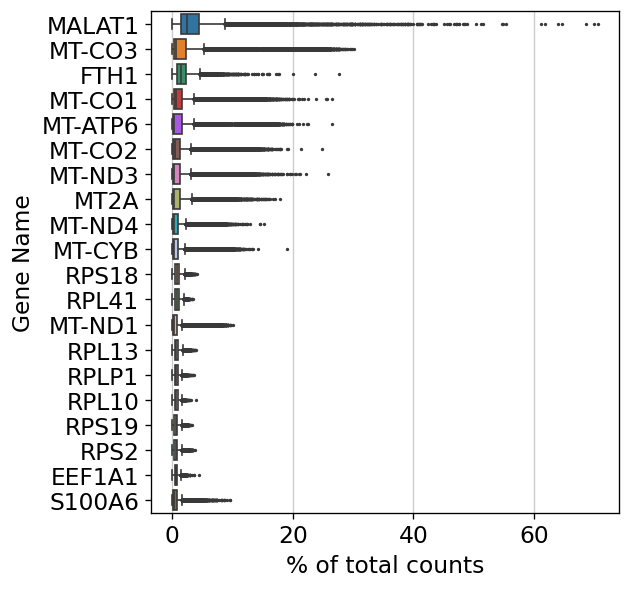

In [8]:
#Show those genes that yield the highest fraction of counts in each single cell, across all cells.
sc.pl.highest_expr_genes(adata, n_top=20)

In [9]:
# Filtering
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

filtered out 1881 cells that have less than 200 genes expressed
filtered out 8859 genes that are detected in less than 3 cells


#Quality Control

In [10]:
# Check mitochondrial genes
adata.var["mt"] = adata.var_names.str.startswith("MT-")
# ribosomal genes
adata.var["ribo"] = adata.var_names.str.startswith(("RPS", "RPL"))
# hemoglobin genes
adata.var["hb"] = adata.var_names.str.contains("^HB[^(P)]")

In [11]:
# account for Mitochindria
adata.var[adata.var['mt'] == True]

,EnsemblId,Gene Name Full,Info,n_cells,mt,ribo,hb
Gene Name,,,,,,,
MT-ND1,ENSG00000198888,MT-ND1,Gene Expression,42687,True,False,False
MT-ND2,ENSG00000198763,MT-ND2,Gene Expression,43375,True,False,False
MT-CO1,ENSG00000198804,MT-CO1,Gene Expression,44216,True,False,False
MT-CO2,ENSG00000198712,MT-CO2,Gene Expression,43414,True,False,False
MT-ATP8,ENSG00000228253,MT-ATP8,Gene Expression,14291,True,False,False
MT-ATP6,ENSG00000198899,MT-ATP6,Gene Expression,43528,True,False,False
MT-CO3,ENSG00000198938,MT-CO3,Gene Expression,44090,True,False,False
MT-ND3,ENSG00000198840,MT-ND3,Gene Expression,39091,True,False,False
MT-ND4L,ENSG00000212907,MT-ND4L,Gene Expression,28531,True,False,False


In [12]:
adata.var[adata.var['ribo'] == True]

,EnsemblId,Gene Name Full,Info,n_cells,mt,ribo,hb
Gene Name,,,,,,,
RPL22,ENSG00000116251,RPL22,Gene Expression,41604,False,True,False
RPL11,ENSG00000142676,RPL11,Gene Expression,44027,False,True,False
RPS6KA1,ENSG00000117676,RPS6KA1,Gene Expression,6042,False,True,False
RPS8,ENSG00000142937,RPS8,Gene Expression,44039,False,True,False
RPL5,ENSG00000122406,RPL5,Gene Expression,43271,False,True,False
...,...,...,...,...,...,...,...
RPS9,ENSG00000170889,RPS9,Gene Expression,43752,False,True,False
RPL28,ENSG00000108107,RPL28,Gene Expression,43397,False,True,False
RPS5,ENSG00000083845,RPS5,Gene Expression,43358,False,True,False


In [13]:
adata.var[adata.var['hb'] == True]

,EnsemblId,Gene Name Full,Info,n_cells,mt,ribo,hb
Gene Name,,,,,,,
HBEGF,ENSG00000113070,HBEGF,Gene Expression,6207,False,False,True
HBS1L,ENSG00000112339,HBS1L,Gene Expression,8802,False,False,True
HBB,ENSG00000244734,HBB,Gene Expression,170,False,False,True
HBG2,ENSG00000196565,HBG2,Gene Expression,13,False,False,True
HBZ,ENSG00000130656,HBZ,Gene Expression,17,False,False,True
HBM,ENSG00000206177,HBM,Gene Expression,6,False,False,True
HBA2,ENSG00000188536,HBA2,Gene Expression,126,False,False,True
HBA1,ENSG00000206172,HBA1,Gene Expression,249,False,False,True
HBQ1,ENSG00000086506,HBQ1,Gene Expression,58,False,False,True


In [14]:
# compute metrics
sc.pp.calculate_qc_metrics(
    adata, qc_vars=["mt", "ribo", "hb"], inplace=True, log1p=True, percent_top=None,
)

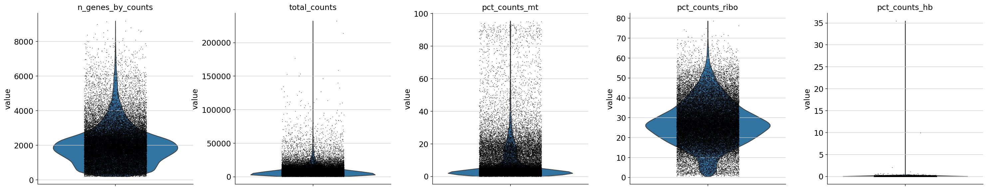

In [15]:
# visualise the metrics
sc.pl.violin(
    adata,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt", "pct_counts_ribo","pct_counts_hb"],
    jitter=0.2,
    multi_panel=True #,save='_violin1_plot.png'
)

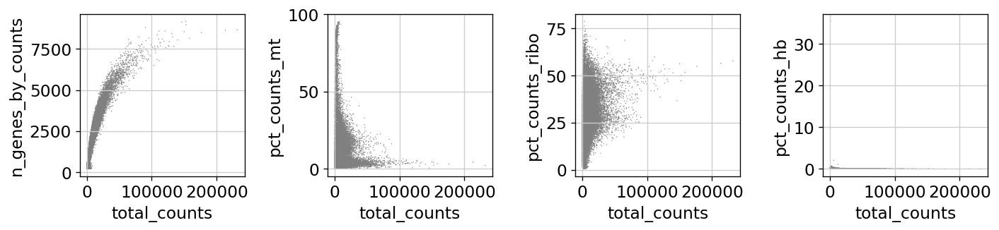

In [16]:
# Create a figure with multiple plots
fig, axs = plt.subplots(1,4, figsize=(12, 3))  # 1 row, 1 columns

# First scatter plot: Total counts vs. n_genes_by_counts
sc.pl.scatter(adata, x="total_counts", y="n_genes_by_counts", ax=axs[0], show=False)

# Second scatter plot: Total counts colored by pct_counts_mt
sc.pl.scatter(adata, x="total_counts", y="pct_counts_mt", ax=axs[1], show=False)

# Third scatter plot: Total counts colored by pct_counts_ribo
sc.pl.scatter(adata, x="total_counts", y="pct_counts_ribo", ax=axs[2], show=False)

# Third scatter plot: Total counts colored by pct_counts_hb
sc.pl.scatter(adata, x="total_counts", y="pct_counts_hb", ax=axs[3], show=False)

# Adjust the spacing between subplots
plt.tight_layout()
# Show the combined plot
plt.show()



In [17]:
# filter genes
adata = adata[adata.obs.n_genes_by_counts < 6500, :]
adata = adata[adata.obs.total_counts < 50000, :]
adata = adata[adata.obs.pct_counts_mt < 40, :]
adata = adata[adata.obs.pct_counts_ribo < 70, :]
adata = adata[adata.obs.pct_counts_hb < 0.04, :]

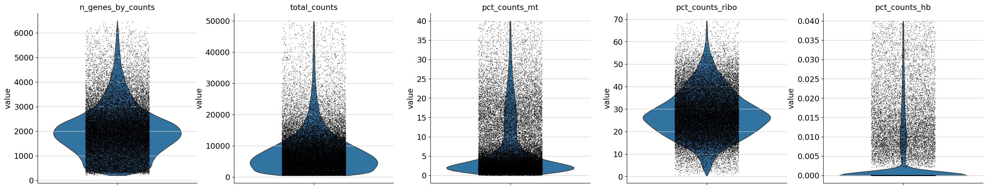

In [18]:
sc.pl.violin(
    adata,
    ["n_genes_by_counts", "total_counts","pct_counts_mt", "pct_counts_ribo","pct_counts_hb"],
    jitter=0.2,
    multi_panel=True
)

In [19]:
adata

View of AnnData object with n_obs × n_vars = 40822 × 24679
    obs: 'batch', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb'
    var: 'EnsemblId', 'Gene Name Full', 'Info', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

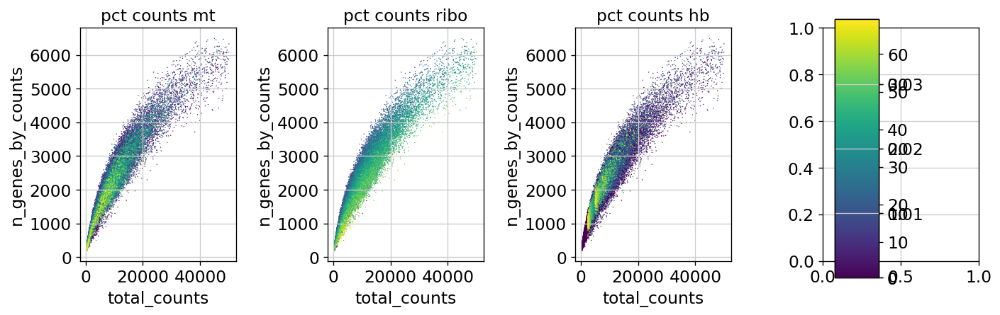

In [20]:

# Create a figure with multiple plots side-by-side
fig, axs = plt.subplots(1,4, figsize=(12, 4))  # 1 row, 3 columns

# First scatter plot: Total counts vs. n_genes_by_counts colored by pct_counts_mt
sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_mt", ax=axs[0], show=False)

# Second scatter plot: Total counts vs. n_genes_by_counts colored by pct_counts_ribo
sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_ribo", ax=axs[1], show=False)

# Third scatter plot: Total counts vs. n_genes_by_counts colored by pct_counts_hb
sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_hb", ax=axs[2], show=False)

# Adjust the spacing between subplots
plt.tight_layout()
# Show the combined plot
plt.show()



In [21]:
#futher fltering
sc.pp.filter_cells(adata, min_genes=100)
sc.pp.filter_genes(adata, min_cells=3)

filtered out 328 genes that are detected in less than 3 cells


In [22]:
adata.obs.head()

,batch,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,total_counts_ribo,log1p_total_counts_ribo,pct_counts_ribo,total_counts_hb,log1p_total_counts_hb,pct_counts_hb
barcode,,,,,,,,,,,,,,,
AAACCTGAGACTAGGC-1-GSM4909253_N,GSM4909253_N,1359,1359,7.215240,3587.0,8.185350,287.0,5.662961,8.001115,1220.0,7.107426,34.011711,0.0,0.0,0.0
AAACCTGAGGACAGAA-1-GSM4909253_N,GSM4909253_N,510,510,6.236370,1003.0,6.911747,4.0,1.609438,0.398804,415.0,6.030685,41.375874,0.0,0.0,0.0
AAACCTGCAAGAGGCT-1-GSM4909253_N,GSM4909253_N,2595,2595,7.861727,10366.0,9.246383,408.0,6.013715,3.935944,2854.0,7.956827,27.532318,0.0,0.0,0.0
AAACCTGGTAGCTTGT-1-GSM4909253_N,GSM4909253_N,734,734,6.599870,1628.0,7.395721,43.0,3.784190,2.641278,481.0,6.177944,29.545454,0.0,0.0,0.0
AAACGGGAGAGGTAGA-1-GSM4909253_N,GSM4909253_N,455,455,6.122493,1230.0,7.115582,26.0,3.295837,2.113821,382.0,5.948035,31.056911,0.0,0.0,0.0


#Doublet Detection

In [23]:
# Filter Doublets
sc.pp.scrublet(adata, batch_key="batch")

Running Scrublet
filtered out 5731 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
    using data matrix X directly
Automatically set threshold at doublet score = 0.52
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 6.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 2.3%
filtered out 4600 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.

In [24]:
adata.obs['batch'].unique()

array(['GSM4909253_N', 'GSM4909254_N', 'GSM4909255_N_EP',
       'GSM4909256_N_EP', 'GSM4909257_N', 'GSM4909258_N_EP',
       'GSM4909259_N_EP', 'GSM4909260_N_EP', 'GSM4909261_N',
       'GSM4909263_N'], dtype=object)

In [25]:
# Check For Doublet
adata.obs['predicted_doublet'].value_counts()

,count
predicted_doublet,
False,40639
True,183


In [26]:
#Remove Doublets
adata_filtered = adata[~adata.obs['predicted_doublet'], :]
adata_filtered.obs.head()

,batch,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,total_counts_ribo,log1p_total_counts_ribo,pct_counts_ribo,total_counts_hb,log1p_total_counts_hb,pct_counts_hb,doublet_score,predicted_doublet
barcode,,,,,,,,,,,,,,,,,
AAACCTGAGACTAGGC-1-GSM4909253_N,GSM4909253_N,1359,1359,7.215240,3587.0,8.185350,287.0,5.662961,8.001115,1220.0,7.107426,34.011711,0.0,0.0,0.0,0.030505,False
AAACCTGAGGACAGAA-1-GSM4909253_N,GSM4909253_N,510,510,6.236370,1003.0,6.911747,4.0,1.609438,0.398804,415.0,6.030685,41.375874,0.0,0.0,0.0,0.045359,False
AAACCTGCAAGAGGCT-1-GSM4909253_N,GSM4909253_N,2594,2595,7.861727,10366.0,9.246383,408.0,6.013715,3.935944,2854.0,7.956827,27.532318,0.0,0.0,0.0,0.091116,False
AAACCTGGTAGCTTGT-1-GSM4909253_N,GSM4909253_N,733,734,6.599870,1628.0,7.395721,43.0,3.784190,2.641278,481.0,6.177944,29.545454,0.0,0.0,0.0,0.015625,False
AAACGGGAGAGGTAGA-1-GSM4909253_N,GSM4909253_N,455,455,6.122493,1230.0,7.115582,26.0,3.295837,2.113821,382.0,5.948035,31.056911,0.0,0.0,0.0,0.081933,False


In [27]:
adata_filtered.obs.tail()

,batch,n_genes,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,total_counts_ribo,log1p_total_counts_ribo,pct_counts_ribo,total_counts_hb,log1p_total_counts_hb,pct_counts_hb,doublet_score,predicted_doublet
barcode,,,,,,,,,,,,,,,,,
TTTGTCAGTCTGCAAT-1-GSM4909263_N,GSM4909263_N,1116,1117,7.019297,2075.0,7.638198,35.0,3.583519,1.686747,232.0,5.451038,11.180723,0.0,0.0,0.0,0.098814,False
TTTGTCAGTGCTTCTC-1-GSM4909263_N,GSM4909263_N,1651,1655,7.412160,3990.0,8.291797,309.0,5.736572,7.744361,817.0,6.706862,20.476191,0.0,0.0,0.0,0.030965,False
TTTGTCAGTTACTGAC-1-GSM4909263_N,GSM4909263_N,1282,1283,7.157735,3502.0,8.161375,142.0,4.962845,4.054826,974.0,6.882438,27.812677,0.0,0.0,0.0,0.082759,False
TTTGTCATCACTCTTA-1-GSM4909263_N,GSM4909263_N,262,262,5.572154,542.0,6.297109,104.0,4.653960,19.188192,15.0,2.772589,2.767528,0.0,0.0,0.0,0.021212,False
TTTGTCATCGAATGCT-1-GSM4909263_N,GSM4909263_N,833,833,6.726233,2090.0,7.645398,33.0,3.526361,1.578947,329.0,5.799093,15.741627,0.0,0.0,0.0,0.021212,False


In [28]:
adata_filtered

View of AnnData object with n_obs × n_vars = 40639 × 24351
    obs: 'batch', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'doublet_score', 'predicted_doublet'
    var: 'EnsemblId', 'Gene Name Full', 'Info', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'scrublet'

In [29]:
# Save the filtered dataset
#adata_filtered.write('filtered_data_no_doublets.h5ad')


#Normalisation

In [30]:
# preserve counts
adata_filtered.layers["counts"] = adata_filtered.X.copy()

In [31]:
adata_filtered

AnnData object with n_obs × n_vars = 40639 × 24351
    obs: 'batch', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'doublet_score', 'predicted_doublet'
    var: 'EnsemblId', 'Gene Name Full', 'Info', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'scrublet'
    layers: 'counts'

In [32]:
# Normalizing to median total counts
sc.pp.normalize_total(adata_filtered, target_sum=1e4)
# Logarithmize the data, log(expression + 1)
sc.pp.log1p(adata_filtered)

normalizing counts per cell
    finished (0:00:00)


In [33]:
adata_filtered

AnnData object with n_obs × n_vars = 40639 × 24351
    obs: 'batch', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'doublet_score', 'predicted_doublet'
    var: 'EnsemblId', 'Gene Name Full', 'Info', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'scrublet', 'log1p'
    layers: 'counts'

#Feature Selection

In [34]:
# Identify highly variable genes
sc.pp.highly_variable_genes(adata_filtered, min_mean=0.0125, max_mean=3, min_disp=0.5)


extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


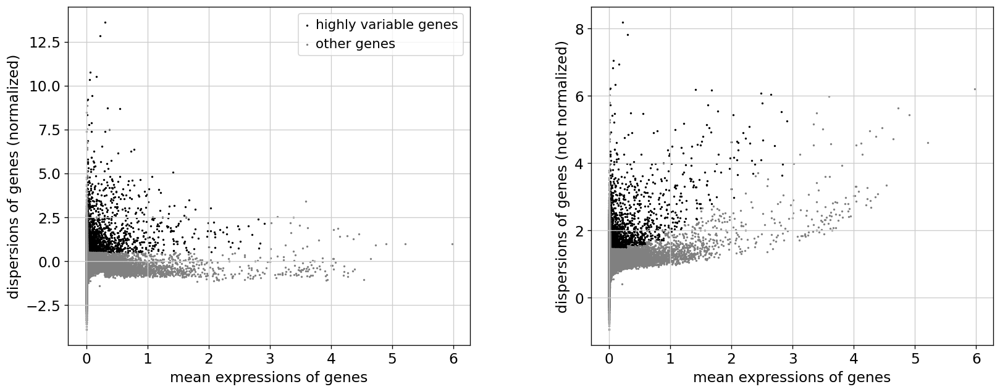

In [35]:
sc.pl.highly_variable_genes(adata_filtered)

In [36]:
adata_filtered.raw = adata_filtered

In [37]:
# Filter the AnnData object to keep only these highly variable genes
adata_filtered = adata_filtered[:, adata_filtered.var.highly_variable]

In [38]:
#Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed
sc.pp.regress_out(adata_filtered, ["total_counts", "pct_counts_mt"])
#Regress out effects of total counts per cell and the percentage of ribosomal genes expressed
sc.pp.regress_out(adata_filtered, ["total_counts", "pct_counts_ribo"])
#Regress out effects of total counts per cell and the percentage of heamoglobin genes expressed
sc.pp.regress_out(adata_filtered, ["total_counts", "pct_counts_hb"])

regressing out ['total_counts', 'pct_counts_mt']
    sparse input is densified and may lead to high memory use
    finished (0:01:33)
regressing out ['total_counts', 'pct_counts_ribo']
    finished (0:00:59)
regressing out ['total_counts', 'pct_counts_hb']
    finished (0:00:59)


In [39]:
#After normalization and identification of highly variable genes, the data is often scaled to unit variance and zero mean.
# Scale each gene to its unit variance. Clip values exceeding standard deviation 10
sc.pp.scale(adata_filtered, max_value=10)

In [40]:
adata_filtered

AnnData object with n_obs × n_vars = 40639 × 2082
    obs: 'batch', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'doublet_score', 'predicted_doublet'
    var: 'EnsemblId', 'Gene Name Full', 'Info', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'scrublet', 'log1p', 'hvg'
    layers: 'counts'

#Dimentionality Reduction (PCA analysis)



In [41]:
sc.tl.pca(adata_filtered)

computing PCA
    with n_comps=50
    finished (0:00:21)


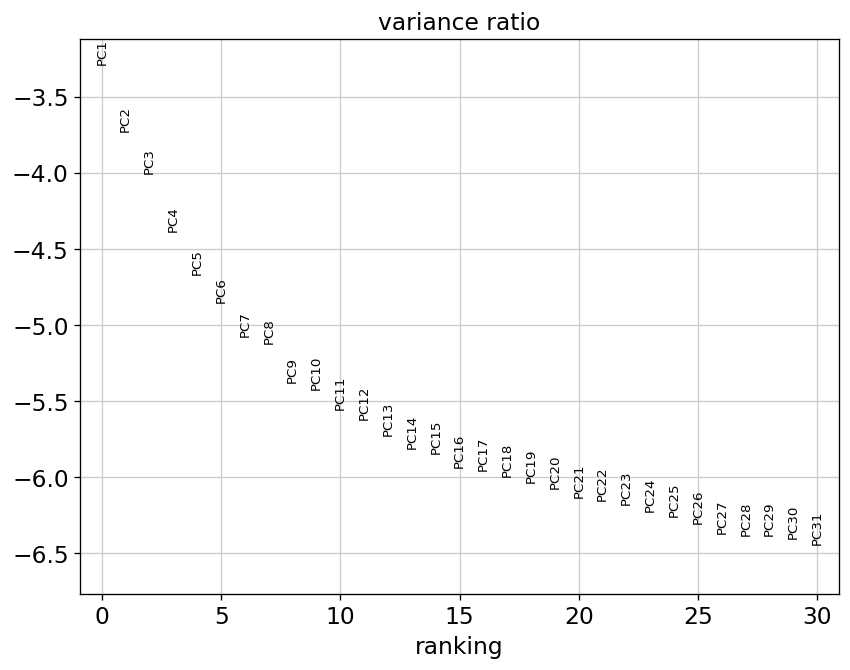

In [42]:
sc.pl.pca_variance_ratio(adata_filtered, log=True)

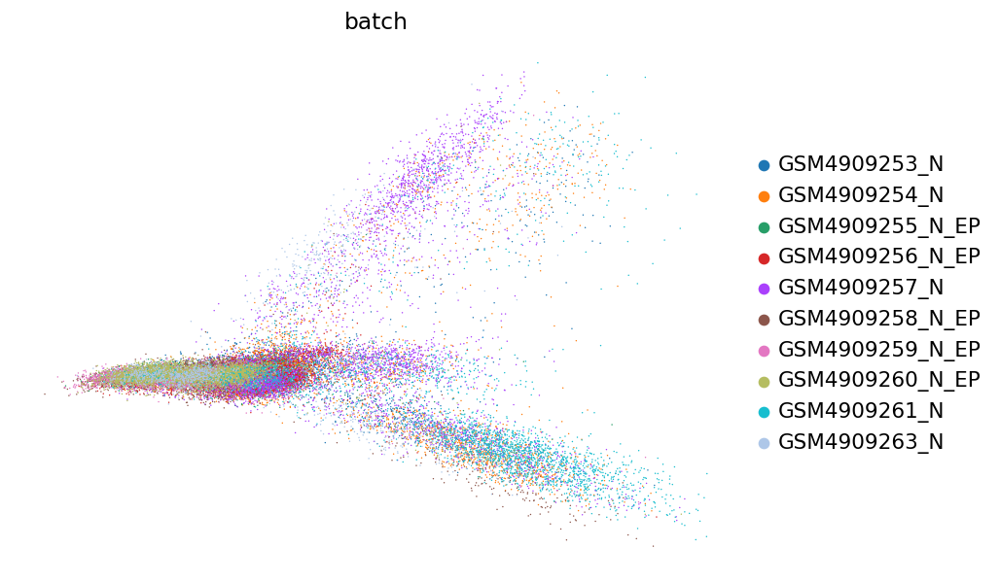

In [43]:
sc.pl.pca(adata_filtered, color='batch')

In [44]:
adata_filtered.var_names

Index(['ISG15', 'TNFRSF4', 'MXRA8', 'AL645728', 'SKI', 'AL139246-2', 'KLHL21',
       'PER3', 'TNFRSF9', 'AL034417',
       ...
       'MX1', 'ABCG1', 'TFF3', 'TFF1', 'SIK1', 'COL18A1', 'COL6A1', 'COL6A2',
       'AP001469-2', 'S100B'],
      dtype='object', name='Gene Name', length=2082)

In [45]:
# sc.pl.pca(adata_filtered, color=['ISG15', 'MX1', 'COL6A2'])

In [46]:
adata_filtered.write('filtered_data_normalised.h5ad')

#Nearest Neighbour Graph Construction and Visualization

In [47]:
sc.pp.neighbors(adata_filtered)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:14)


#Batch Effect Correction

In [48]:
# BBKNN
sc.external.pp.bbknn(adata_filtered, batch_key="batch")

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:16)


In [49]:
# Compute and visualise with UMAP
sc.tl.umap(adata_filtered, random_state=0)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:52)


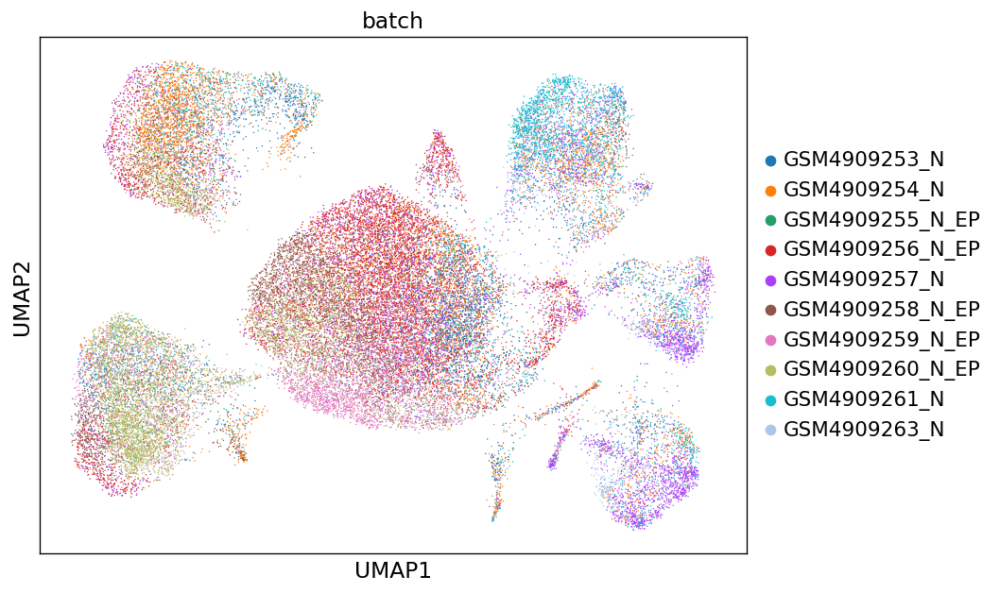

In [50]:
sc.pl.umap(adata_filtered,color="batch",frameon=True)

#Clustering

In [51]:
# Checking for number of clusters
sc.tl.leiden(adata_filtered, flavor="igraph", n_iterations=2, random_state=0, directed=False)

running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:06)


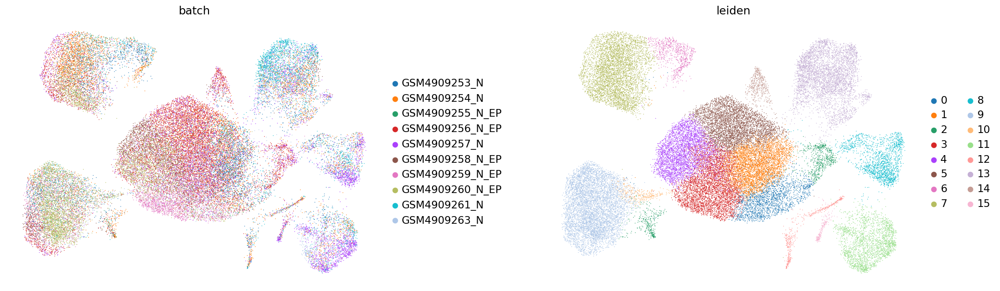

In [52]:
sc.pl.umap(adata_filtered, color=["batch", "leiden"], wspace=0.3)

In [53]:
#Checking for clusters with different resolutions
sc.tl.leiden(adata_filtered, flavor="igraph", key_added="leiden_res0_02", resolution=0.02 , random_state=0, directed=False)
sc.tl.leiden(adata_filtered, flavor="igraph", key_added="leiden_res0_5", resolution=0.5 , random_state=0, directed=False)
sc.tl.leiden(adata_filtered, flavor="igraph", key_added="leiden_res1", resolution=1 , random_state=0, directed=False)

running Leiden clustering
    finished: found 3 clusters and added
    'leiden_res0_02', the cluster labels (adata.obs, categorical) (0:00:04)
running Leiden clustering
    finished: found 13 clusters and added
    'leiden_res0_5', the cluster labels (adata.obs, categorical) (0:00:03)
running Leiden clustering
    finished: found 16 clusters and added
    'leiden_res1', the cluster labels (adata.obs, categorical) (0:00:03)


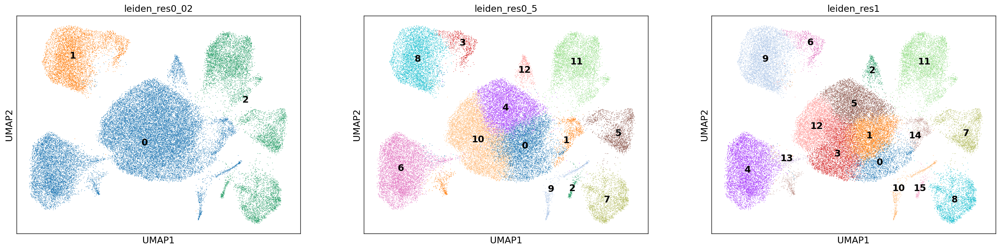

In [54]:
#plot umap to visualise
sc.pl.umap(
    adata_filtered,
    color=["leiden_res0_02", "leiden_res0_5", "leiden_res1"],
    legend_loc="on data",
    frameon=True,

)

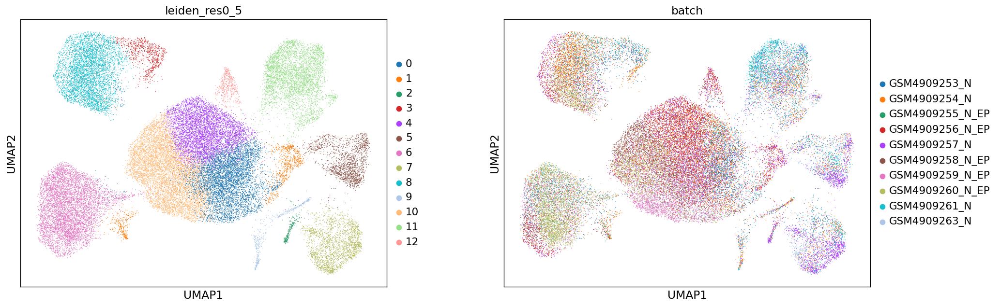

In [55]:
# cluster and batch visualisation
sc.pl.umap(adata_filtered, color=["leiden_res0_5", "batch"],  frameon=True, wspace=0.2)

In [56]:
# Vsualising on the genes
#sc.pl.umap(adata_filtered, color=["leiden_res0_5", "CD93", "AREG"])

#Finding Marker Genes

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:13)


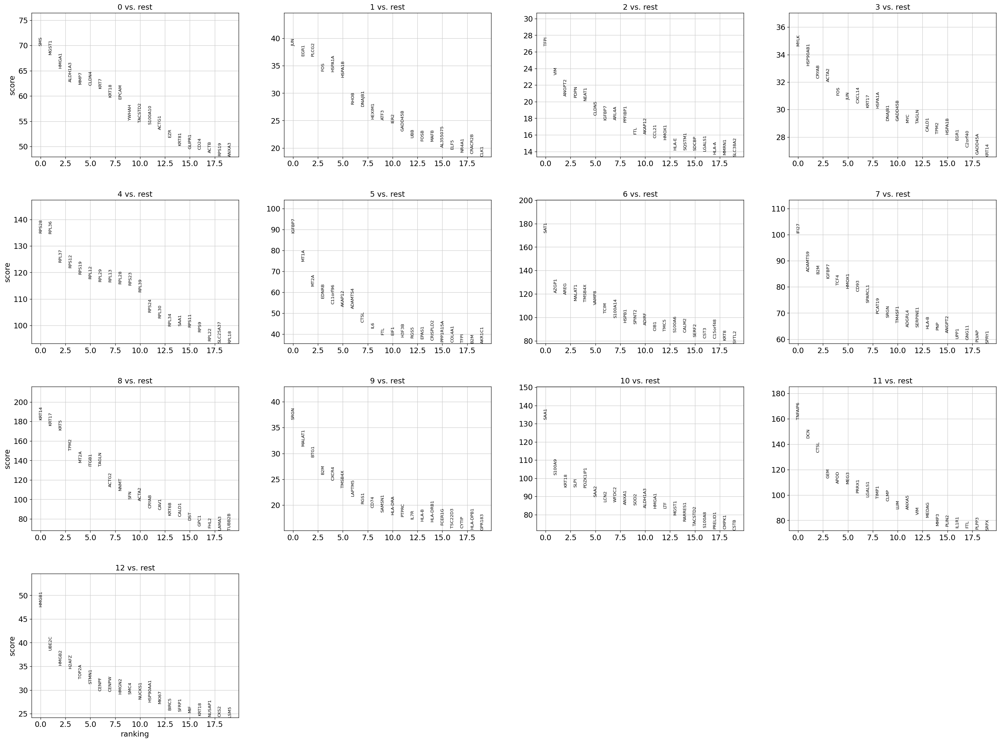

In [57]:
sc.tl.rank_genes_groups(adata_filtered, "leiden_res0_5", method="t-test")
sc.pl.rank_genes_groups(adata_filtered, n_genes=20, sharey=False) #, save = '_gene_rank.png')

In [58]:
sc.settings.verbosity = 2  # reduce the verbosity

In [59]:
#adata_filtered.write('adata_genes_groups.h5ad')

In [60]:
pd.DataFrame(adata_filtered.uns["rank_genes_groups"]["names"]).head(30)

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,SMS,JUN,TFPI,MYLK,RPS28,IGFBP7,SAT1,IFI27,KRT14,SRGN,SAA1,TNFAIP6,HMGB1
1,MGST1,EGR1,VIM,HSP90AB1,RPL36,MT1A,AZGP1,ADAMTS9,KRT17,MALAT1,S100A9,DCN,UBE2C
2,HMGA1,PLCG2,ANGPT2,CRYAB,RPL37,MT2A,AREG,B2M,KRT5,BTG1,KRT18,CTSL,HMGB2
3,ALDH1A3,FOS,PDPN,ACTA2,RPS12,EDNRB,MALAT1,IGFBP7,TPM2,B2M,SLPI,GEM,H2AFZ
4,MMP7,HSPA1A,NEAT1,FOS,RPS19,C11orf96,TMSB4X,TCF4,MT2A,CXCR4,PDZK1IP1,APOD,TOP2A
5,CLDN4,HSPA1B,CLDN5,JUN,RPL12,AKAP12,VAMP8,HMOX1,ITGB1,TMSB4X,SAA2,MEG3,STMN1
6,KRT7,RHOB,IGFBP7,CXCL14,RPL29,ADAMTS4,TCIM,CD93,TAGLN,LAPTM5,LCN2,PRRX1,CENPF
7,KRT18,DNAJB1,ARL4A,KRT17,RPL13,CTSL,S100A14,SPARCL1,ACTG2,RGS1,WFDC2,LGALS1,CENPW
8,EPCAM,HEXIM1,PPFIBP1,HSPA1A,RPL28,IL6,HSPB1,PCAT19,NNMT,CD74,ANXA1,TIMP1,HMGN2
9,YWHAH,ATF3,FTL,DNAJB1,RPS23,FTL,SPINT2,SRGN,SFN,SAMSN1,SOD2,CLMP,SMC4


In [61]:
markers = sc.get.rank_genes_groups_df(adata_filtered, None)
markers = markers[(markers.pvals_adj<0.05) & (markers.logfoldchanges.abs()> .5)]
markers.head()

,group,names,scores,logfoldchanges,pvals,pvals_adj
0,0,SMS,69.881493,1.941519,0.0,0.0
1,0,MGST1,68.193687,1.483457,0.0,0.0
2,0,HMGA1,65.519753,1.656539,0.0,0.0
3,0,ALDH1A3,62.742134,1.782672,0.0,0.0
4,0,MMP7,62.341713,2.289826,0.0,0.0


In [62]:
sc.get.rank_genes_groups_df(adata_filtered, group='1').head(10)

,names,scores,logfoldchanges,pvals,pvals_adj
0,JUN,38.600899,3.662529,3.072563e-201,1.870500e-198
1,EGR1,36.776592,4.733744,2.934780e-188,1.429296e-185
2,PLCG2,36.717403,6.834866,1.483125e-187,7.081486e-185
3,FOS,34.038254,4.156744,1.118288e-169,3.583082e-167
4,HSPA1A,33.909275,4.068681,5.609168e-169,1.751139e-166
5,HSPA1B,32.935150,4.305467,4.794461e-162,1.297221e-159
6,RHOB,28.001087,2.736978,2.318563e-128,3.321138e-126
7,DNAJB1,27.588154,3.002119,1.883056e-125,2.561692e-123
8,HEXIM1,25.258736,3.187793,1.932659e-109,1.952787e-107
9,ATF3,25.068056,3.446155,4.226950e-108,4.150422e-106


In [63]:
# Extract the ranked genes for the group '1' into a DataFrame
#ranked_genes_df = sc.get.rank_genes_groups_df(adata_filtered, group='1')

In [64]:
# Slice the DataFrame to get rows 50-100
#subset_df = ranked_genes_df.iloc[50:100]

# Display the sliced DataFrame
#print(subset_df)


In [65]:
#list of marker genes
marker_genes = {
    "Basal cells": ['KRT17'],
    "Basal Epithalial Cells": ['MYLK','KRT14','KRT5'],
    #'Perivascular cells': ['TAGLN','ITGB1'],
    'Myofibroblast': ['VIM'],
    "Luminal Cells": ['KRT18','KRT8'],
    "Luminal Epithalial Cells": ['KRT81','KRT23', 'KRT15'],
    #"Luminal Progenitor Cells": ['KRT19','SLPI'],
    "Epithelial Cells":['EPCAM'],
    "Epithelial Progenitor Cells":['CD24'],
    "Stromal Cells": ['ACTA2'],
    "Pericyte": ['RGS5','TAGLN'],
    #"Cancer Stem Cells": ['ALDH1A3', 'CD24','MYC','PROCR','CXCR4'],
    #"Cancer Cell": ['KRT7','KRT19','TRPS1','GOLM1','ENG','MKI67'],
    "CD8+ T Cells": ['HLA-E','HLA-DRA'],
    "T follicular helper": ['CD200'],
    #"T helper 1": ['ZEB2'],
    "Proliferating T Cell": ['MKI67'],
    "Exhausted CD8+ T Cells": ['HLA-DRB1','ALOX5AP','IFI27','HLA-DRA'],
    #"Antigen Presentation Cancer-Associated Fibrblast": ['CD74', 'CAV1'],
    "Fibroblast": ["DCN"],
    #"Dendritic Cells": ['HLA-DPA1','HLA-DPB1','HLA-DQB1','HLA-DRA'],
    "CD4+ T Cells": ["IL7R"],
    #"Macrophage": ['HLA-DPA1','LAPTM5','CD74','PTPRC'],
    #"Mesenchymal Cells": ['ZEB2', 'SPARC','MMP2'],
    #"T Cells": ['LAPTM5','PTPRC','CFD'],
    "Monocytes": ['S100A8','S100A9'],
    "Myeloid Dendrtic Cells": ['CCR7'],
    #"cancer-associated Fibroblast": ['PDPN','ACTA2','CAV1'],
    "Plasma Cells": ['LAPTM5','PTPRC'],
    "Mammary Stem Cells": ['CXCR4','KRT5','ITGB1','ALDH1A3', 'CD24'],


}


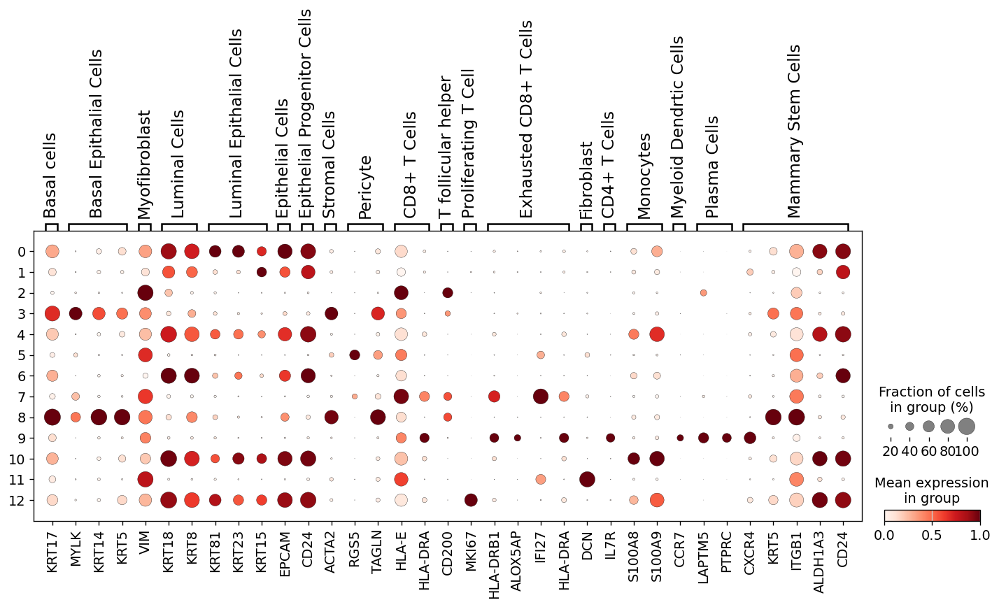

In [66]:
# visualise markers with dot plot
sc.pl.dotplot(adata_filtered, marker_genes, standard_scale="var", groupby='leiden_res0_5')

## VISUALISATION of the identified markers

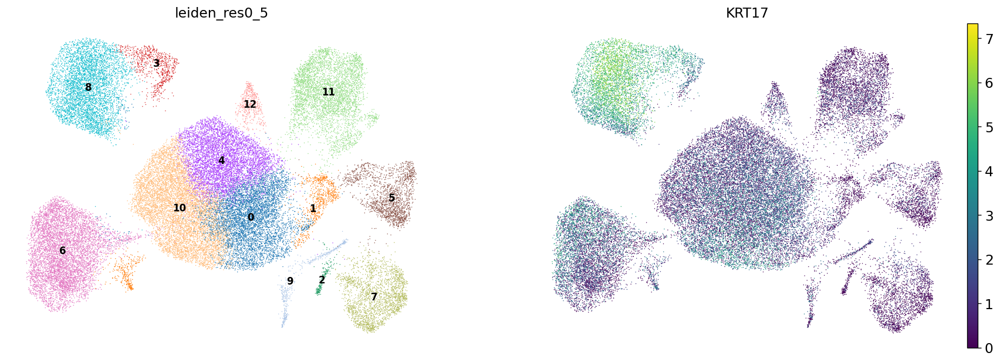

In [67]:
# plot view
sc.pl.umap(adata_filtered, color=["leiden_res0_5",'KRT17'], legend_loc="on data", legend_fontsize=10, frameon=False,) # Basal Cell

In [68]:
sc.pl.umap(adata_filtered, color=["leiden_res0_5",'MYLK','KRT14','KRT5'],legend_loc="on data", legend_fontsize=10, frameon=False,) # Basal Epithalial Cell

Output hidden; open in https://colab.research.google.com to view.

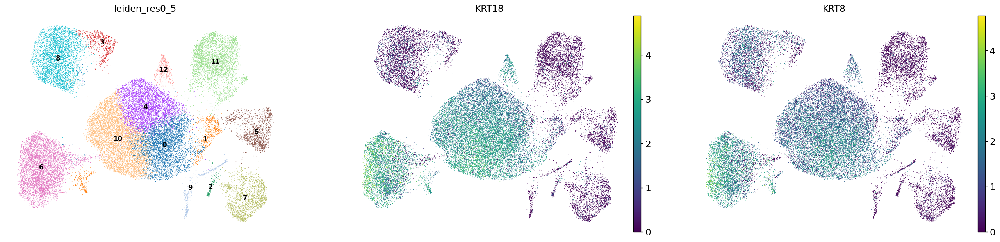

In [69]:
sc.pl.umap(adata_filtered, color=["leiden_res0_5",'KRT18','KRT8'], legend_loc="on data", legend_fontsize=10, frameon=False,) # Luminal cells

In [70]:
sc.pl.umap(adata_filtered, color=["leiden_res0_5",'KRT81','KRT23', 'KRT15'], legend_loc="on data", legend_fontsize=10, frameon=False,) #Luminal Epithelial Cells

Output hidden; open in https://colab.research.google.com to view.

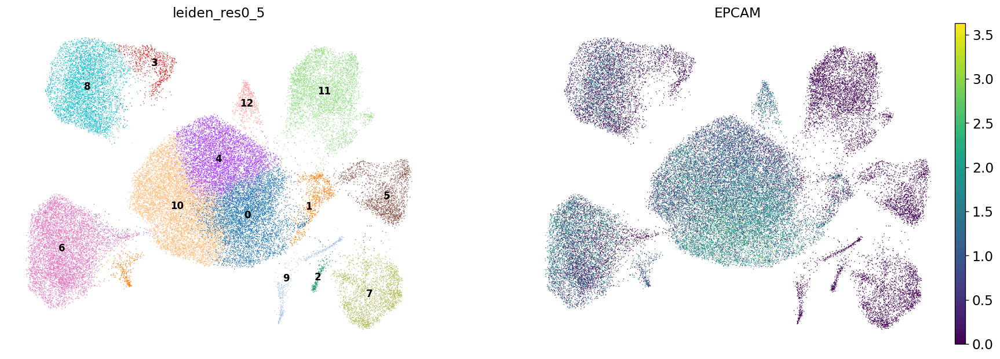

In [71]:
sc.pl.umap(adata_filtered, color=["leiden_res0_5",'EPCAM'], legend_loc="on data", legend_fontsize=10, frameon=False,) # Epithelial Cells

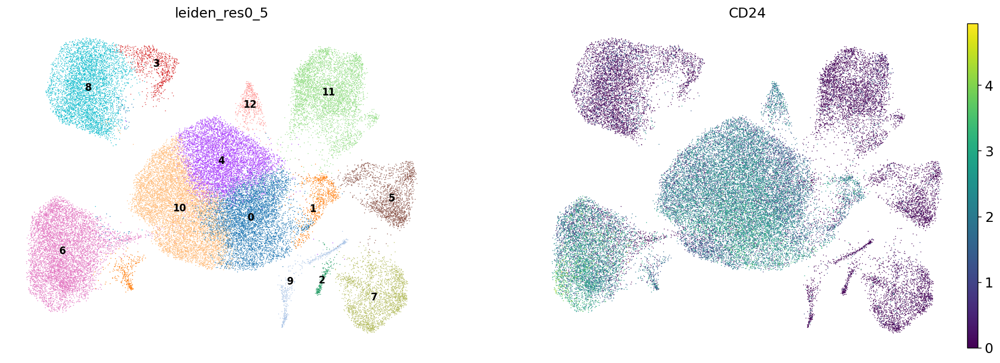

In [72]:
sc.pl.umap(adata_filtered, color=["leiden_res0_5",'CD24'], legend_loc="on data", legend_fontsize=10, frameon=False,) # Epithelial Progenitor Cells

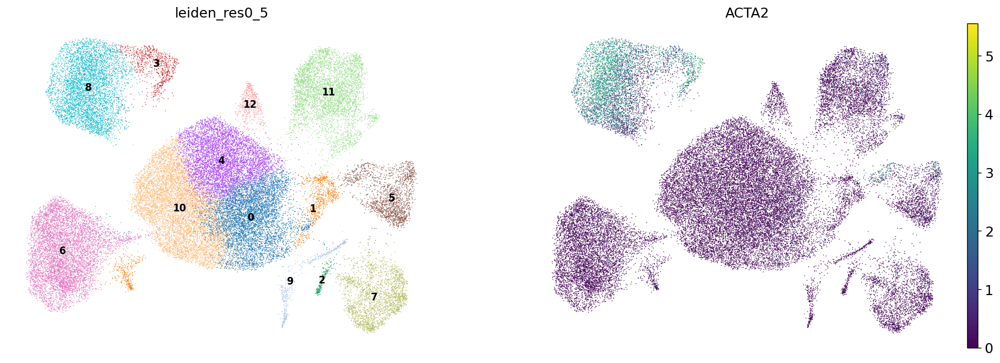

In [73]:
sc.pl.umap(adata_filtered, color=["leiden_res0_5",'ACTA2'], legend_loc="on data", legend_fontsize=10, frameon=False,) # Stromal Cells

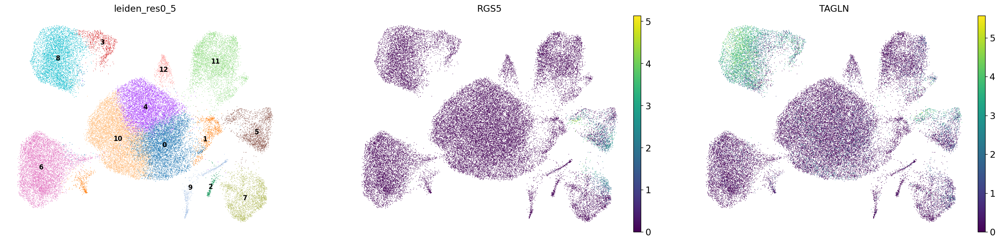

In [74]:
sc.pl.umap(adata_filtered, color=["leiden_res0_5",'RGS5','TAGLN'], legend_loc="on data", legend_fontsize=10, frameon=False,) #Pericytes

In [75]:
# sc.pl.umap(adata_filtered, color=["leiden_res0_5",'CD200'], legend_loc="on data", legend_fontsize=10, frameon=False,) # T Follicular Helper

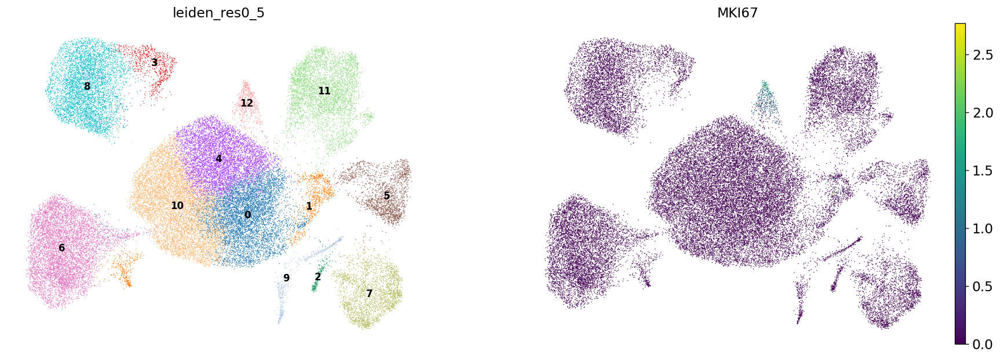

In [76]:
sc.pl.umap(adata_filtered, color=["leiden_res0_5",'MKI67'], legend_loc="on data", legend_fontsize=10, frameon=False,) # Proliferative T Cell

In [77]:
sc.pl.umap(adata_filtered, color=["leiden_res0_5",'HLA-DRB1','IFI27','HLA-DRA'], legend_loc="on data", legend_fontsize=10, frameon=False,) # Exhausted CD8+ T cell

Output hidden; open in https://colab.research.google.com to view.

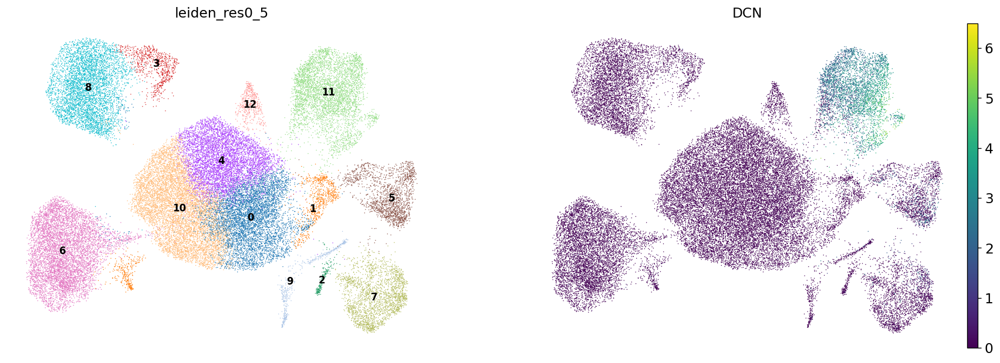

In [78]:
sc.pl.umap(adata_filtered, color=["leiden_res0_5","DCN"], legend_loc="on data", legend_fontsize=10, frameon=False,) # Fibroblast

In [79]:
#sc.pl.umap(adata_filtered, color=["leiden_res0_5","IL7R"], legend_loc="on data", legend_fontsize=10, frameon=False,) # CD4+ T cells

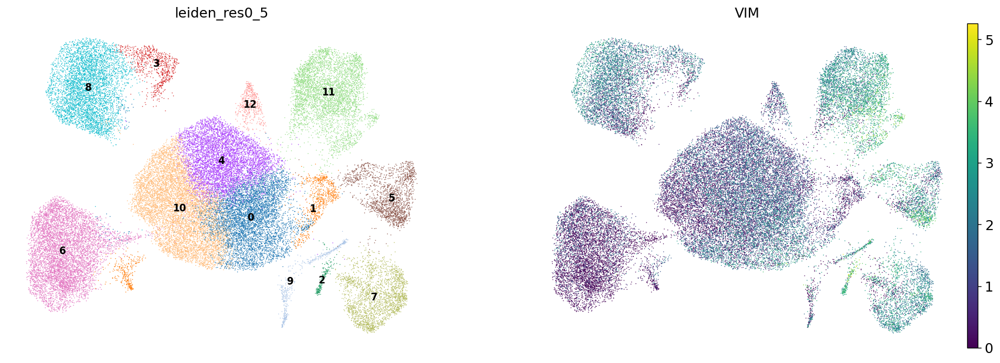

In [80]:
sc.pl.umap(adata_filtered, color=["leiden_res0_5","VIM"], legend_loc="on data", legend_fontsize=10, frameon=False,) # Myofibroblast

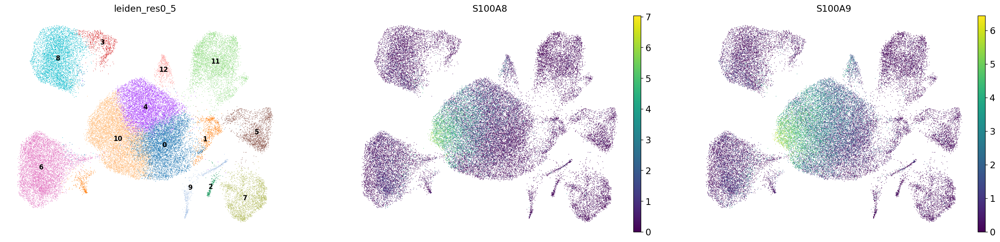

In [81]:
sc.pl.umap(adata_filtered, color=["leiden_res0_5",'S100A8','S100A9'], legend_loc="on data", legend_fontsize=10, frameon=False,) # Monocytes

In [82]:
#sc.pl.umap(adata_filtered, color= ["leiden_res0_5",'PDPN','ACTA2','CAV1'], legend_loc="on data", legend_fontsize=10, frameon=False,) # cancer-associated Fibroblast

In [83]:
#sc.pl.umap(adata_filtered, color=["leiden_res0_5",'LAPTM5','PTPRC'], legend_loc="on data", legend_fontsize=10, frameon=False,) # Plasma Cells

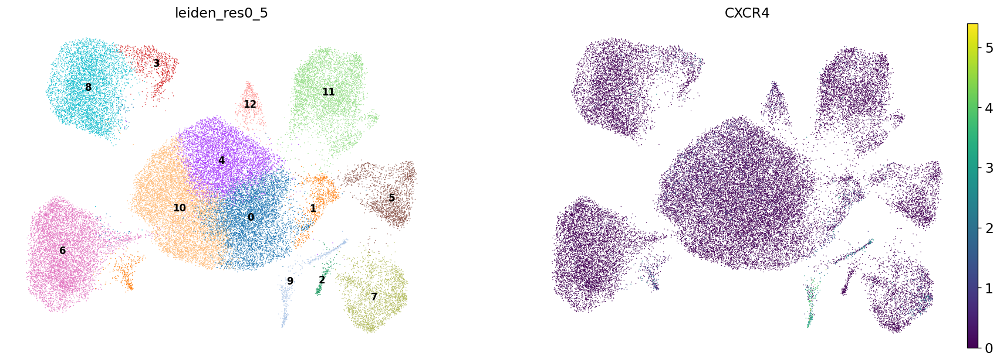

In [84]:
sc.pl.umap(adata_filtered, color=["leiden_res0_5",'CXCR4'], legend_loc="on data", legend_fontsize=10, frameon=False,) # Mammary Stem Cells

In [85]:
#mark the cell types
Cell_Types = {
    "0": "EPCs",
    "1": "LECs",
    "2": "MFB",
    "3": "SCs/BECs",
    "4": "EPCs",
    "5": "PCs",
    "6": "LCs",
    "7": "ExCD8+ TCs",
    "8": "BCs",
    "9": "SCs",
    "10": "MCs",
    "11": "FBs",
    "12": "pT cells",

}
adata_filtered.obs["Cell_Types"] = adata_filtered.obs["leiden_res0_5"].map(Cell_Types)

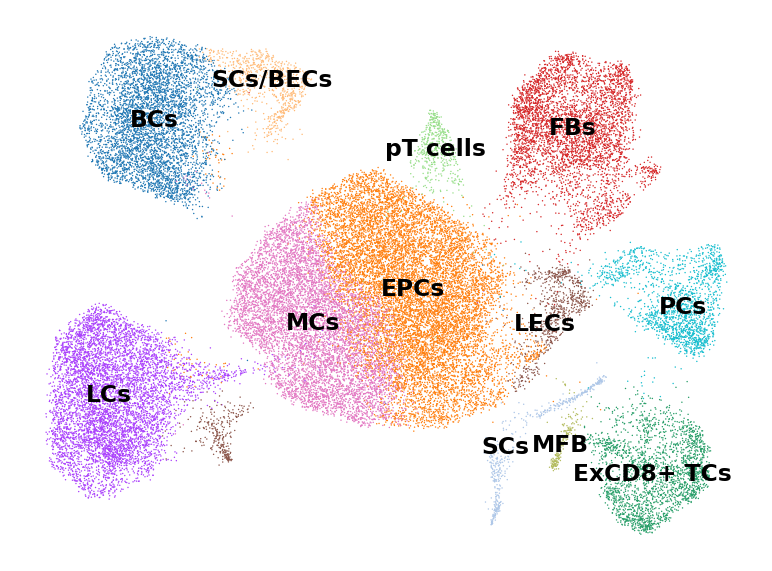

In [86]:
# plot map (annotation)
sc.pl.umap(
    adata_filtered, color = "Cell_Types", legend_loc="on data", title="", frameon=False, #save=".pdf"
)

In [87]:
#mark the cell types
Cell_Types = {
    "0": "Epithalial Cell",
    "1": "Luminal Epithelial Cell",
    "2": "Myofibroblast",
    "3": "Stromal/Basal Epithelial Cell",
    "4": "Epithelial Progenitor Cell",
    "5": "Pericytes",
    "6": "Luminal Cells",
    "7": "Exhausted CD8+ Tcell",
    "8": "Basal cell",
    "9": "Mammary Stem Cell",
    "10": "Monocytes",
    "11": "Fibroblasts",
    "12": "Proliferative T cell",

}
adata_filtered.obs["Cell_Types"] = adata_filtered.obs["leiden_res0_5"].map(Cell_Types)

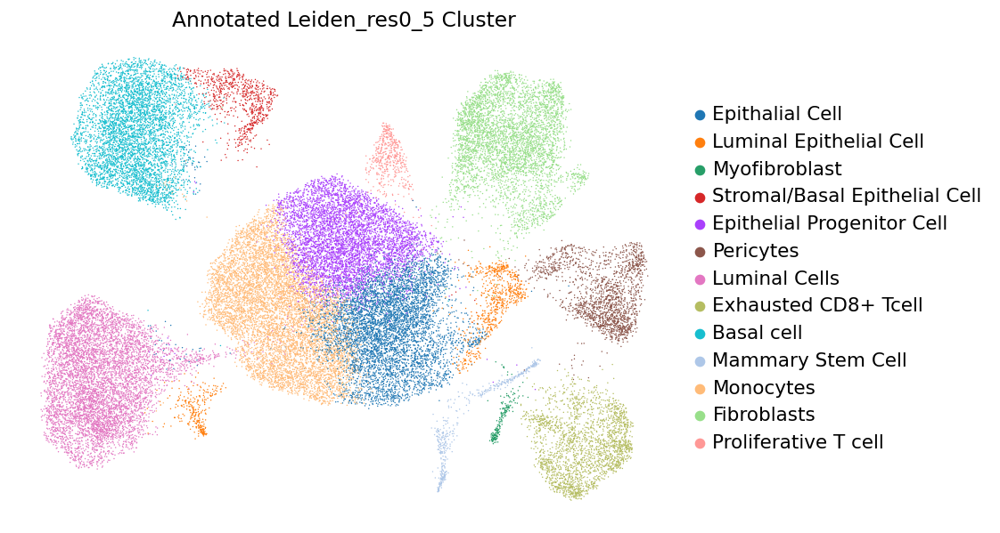

In [88]:
# annotation 2
sc.pl.umap(
    adata_filtered, color = "Cell_Types",  title="Annotated Leiden_res0_5 Cluster", frameon=False, #save=".pdf"
)

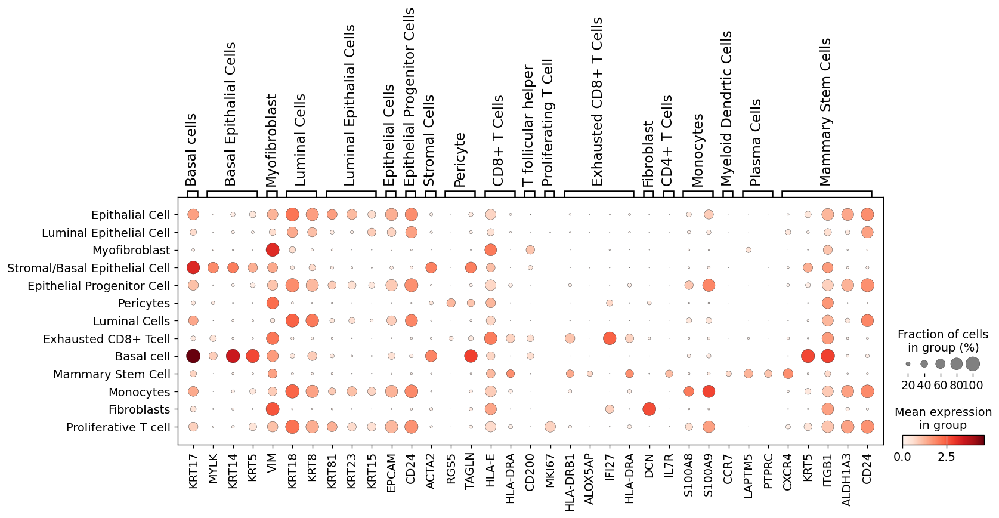

In [89]:
# Label Cell Types
sc.pl.dotplot(adata_filtered, marker_genes, groupby="Cell_Types")

In [90]:
# Silhoutte Score for leiden
from sklearn.metrics import silhouette_score
sil_score_02 = silhouette_score(adata_filtered.obsm['X_umap'], adata_filtered.obs['leiden_res0_02'].astype(int))
sil_score_5 = silhouette_score(adata_filtered.obsm['X_umap'], adata_filtered.obs['leiden_res0_5'].astype(int))
sil_score_1 = silhouette_score(adata_filtered.obsm['X_umap'], adata_filtered.obs['leiden_res1'].astype(int))
print(f'Silhouette Score for Leiden Clustering: {sil_score_02:.4f},{sil_score_5:.4f},{sil_score_1:.4f}')

Silhouette Score for Leiden Clustering: 0.3730,0.3875,0.3340


In [91]:
#adata_filtered

In [92]:
# Trajectory Inference
#sc.tl.paga(adata_filtered, groups="leiden_res0_5")
#sc.pl.paga(adata_filtered, plot=True)  # remove `plot=False` if you want to see the coarse-grained graph
#sc.tl.umap(adata_filtered, init_pos='paga')